In [1]:
import pandas as pd
import numpy as np
import pyedflib
import os
import shutil
import glob
import datetime
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.graph_objects as go

# Enable Auto reloading of modules so source code changes take effect
%load_ext autoreload
%autoreload 2

In [18]:
# Read raw PPG files

mdf = pd.read_csv('../prof_data/resteaze_train/00000177-resteaze-sync.csv', sep=',')
mdf = mdf[['ledGreen', 'sleep_stage', 'sleep_state']].dropna()
mdf.head()

,ledGreen,sleep_stage,sleep_state
1,5019.0,NS,-1.0
3,5020.0,NS,-1.0
5,5020.0,NS,-1.0
7,5020.0,NS,-1.0
9,5017.0,NS,-1.0


<AxesSubplot: xlabel='ledGreen', ylabel='sleep_stage'>

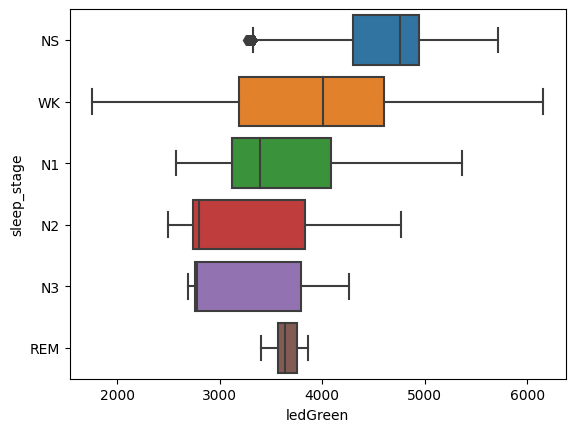

In [19]:
sns.boxplot(x='ledGreen', y='sleep_stage', data=mdf)

In [20]:
mdf = mdf[mdf.sleep_state != -1]

df = mdf[['ledGreen', 'sleep_stage', 'sleep_state']].dropna()
# df['sleep_state'] = df['sleep_state'].mask(lambda col: col == -1, 6)

# Applying the condition
df["sleep_state"] = np.where(df["sleep_state"] == 0, 0, 1)
df.head()

,ledGreen,sleep_stage,sleep_state
13574,4719.0,WK,0
13576,4720.0,WK,0
13578,4724.0,WK,0
13580,4724.0,WK,0
13582,4726.0,WK,0


In [21]:
## Concluded interactive plot for PPG signal

fig = go.Figure(
    data=[go.Scatter(y=mdf['sleep_state']),
        go.Scatter(y=df['sleep_state'])]
)
fig.show()

In [23]:
# Clean PPG files
import neurokit2 as nk

In [26]:
ppg_elgendi = nk.ppg_clean(df['ledGreen'], method='elgendi', sampling_rate=25)

In [27]:
## Concluded interactive plot for PPG signal

fig = go.Figure(data=[go.Scatter(y=ppg_elgendi), go.Scatter(y=df['ledGreen'])])
fig.show()

bpm: 70.581101
ibi: 850.085916
sdnn: 36.219429
sdsd: 33.787654
rmssd: 47.497197
pnn20: 0.667194
pnn50: 0.121257
hr_mad: 0.000000
sd1: 33.585564
sd2: 28.384338
s: 2994.892857
sd1/sd2: 1.183243
breathingrate: 0.249829


c:\Users\lucki\anaconda3\envs\tf\lib\site-packages\heartpy\visualizeutils.py:119: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 2500x400 with 0 Axes>

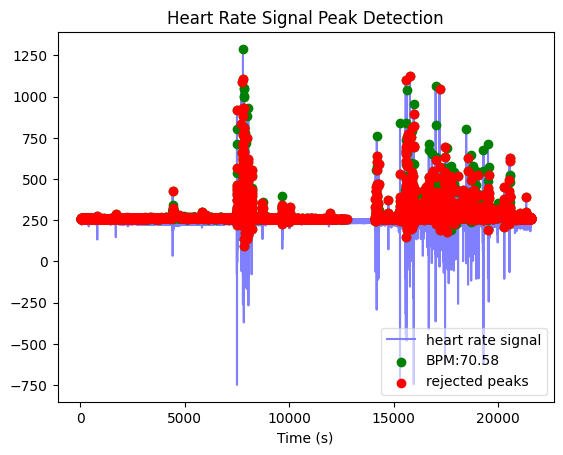

In [30]:
import matplotlib.pyplot as plt
import heartpy as hp

#run the analysis
wd, m = hp.process(np.array(ppg_elgendi), sample_rate=25.0)


#set large figure
plt.figure(figsize=(25,4))

#call plotter
hp.plotter(wd, m)

#display measures computed
for measure in m.keys():
    print('%s: %f' %(measure, m[measure]))

In [31]:
# Process the data
nkdf, info = nk.ppg_process(ppg_elgendi, sampling_rate=25)

# Analyze
analyze_df = nk.ppg_analyze(nkdf, sampling_rate=25)

analyze_df

,PPG_Rate_Mean,HRV_MeanNN,HRV_SDNN,HRV_SDANN1,HRV_SDNNI1,HRV_SDANN2,HRV_SDNNI2,HRV_SDANN5,HRV_SDNNI5,HRV_RMSSD,...,HRV_SampEn,HRV_ShanEn,HRV_FuzzyEn,HRV_MSEn,HRV_CMSEn,HRV_RCMSEn,HRV_CD,HRV_HFD,HRV_KFD,HRV_LZC
0,53.778195,1157.902308,599.558716,123.866152,579.174216,92.910622,579.480778,82.084759,585.123467,824.324181,...,0.645774,3.538148,0.865261,0.222439,0.908174,0.748649,0.527803,2.004141,2.783153,0.86041


In [40]:
analyze_df.T

,0
PPG_Rate_Mean,5.377820e+01
HRV_MeanNN,1.157902e+03
HRV_SDNN,5.995587e+02
HRV_SDANN1,1.238662e+02
HRV_SDNNI1,5.791742e+02
HRV_SDANN2,9.291062e+01
HRV_SDNNI2,5.794808e+02
HRV_SDANN5,8.208476e+01
HRV_SDNNI5,5.851235e+02
HRV_RMSSD,8.243242e+02


In [39]:
pd.set_option('display.max_rows', 100)